In [1]:
import matplotlib.pyplot as plt
import missingno as msno
import numpy as np
import pandas as pd
import os
from pprint import pprint
from plotly import tools
import plotly.offline as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
from util import categorize_kda

py.init_notebook_mode(connected=True)
PATH = 'data'

train = pd.read_csv(os.path.join(PATH, 'train_tier.csv'))
print(train.shape)

(23910, 11)


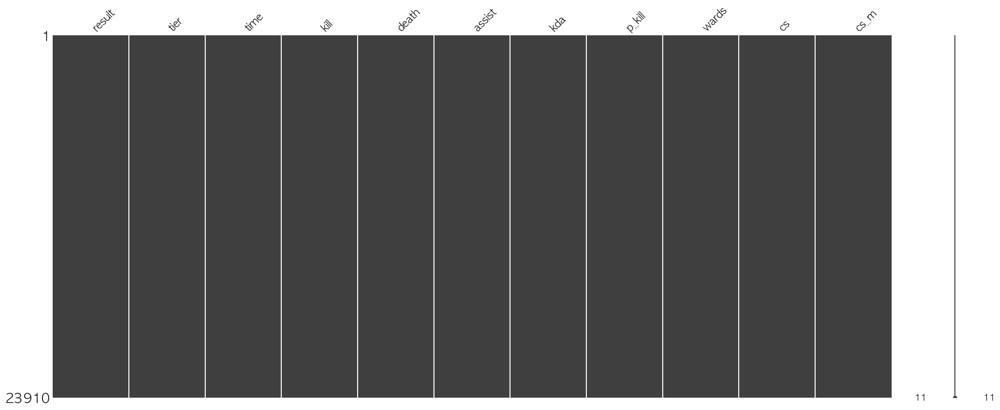

In [2]:
msno.matrix(train)

In [3]:
train.head()

,result,tier,time,kill,death,assist,kda,p_kill,wards,cs,cs_m
0,Victory,Master,19.98,4.0,4.0,4.0,2.000000,0.33,0.0,185.0,9.3
1,Victory,Challenger,22.37,5.0,0.0,5.0,inf,0.45,2.0,154.0,6.9
2,Defeat,Diamond 1,15.57,1.0,5.0,1.0,0.400000,0.22,1.0,67.0,4.3
3,Defeat,Diamond 1,22.25,9.0,6.0,6.0,2.500000,0.60,3.0,101.0,4.5
4,Defeat,Master,24.48,2.0,5.0,8.0,2.000000,0.67,3.0,146.0,6.0


In [4]:
train_cols = train.columns
print('There are {} columns in data'.format(len(train_cols)))
print('-'*30)
pprint(train_cols.tolist())

There are 11 columns in data
------------------------------
['result',
 'tier',
 'time',
 'kill',
 'death',
 'assist',
 'kda',
 'p_kill',
 'wards',
 'cs',
 'cs_m']


## 1. 승패와 Kill/Death/Assist의 상관관계

- 승리 시에 Kill/Assist 모두 증가
- 패배 시에는 Death가 더 많이 발생
- Kill/Death/Assist 사이의 상관관계는 약함

In [5]:
fig = tools.make_subplots(rows=1, cols=3)
data = []
for idx, val in enumerate(['kill', 'death', 'assist']):
    trace = go.Box(
        x=train['result'],
        y=train[val],
        name=val,
        opacity=0.8,
    )
    data.append(trace)
    
for idx, val in enumerate(data):
    fig.append_trace(val, 1, idx+1)

fig['layout'].update(title='KDA by result')
py.iplot(fig)

This is the format of your plot grid:
[ (1,1) x1,y1 ]  [ (1,2) x2,y2 ]  [ (1,3) x3,y3 ]



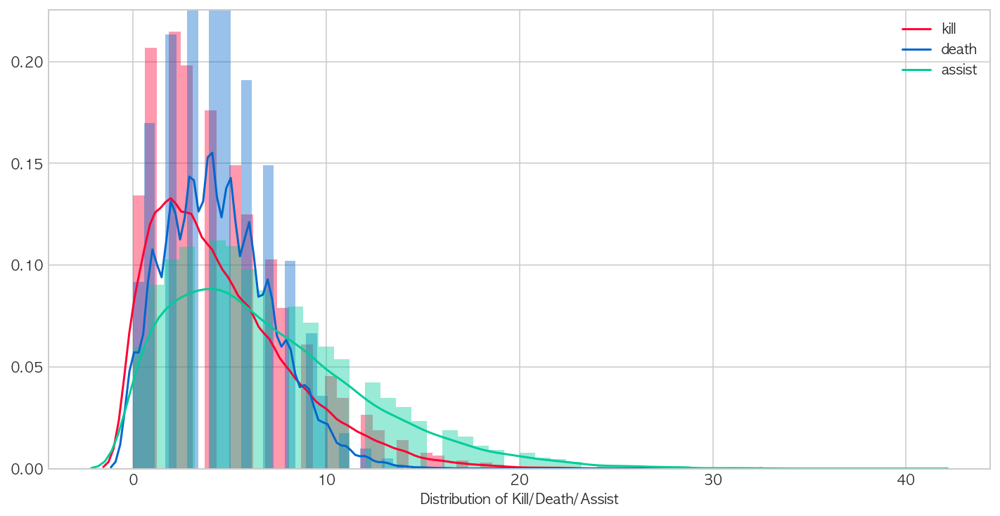

In [6]:
cols = ['kill', 'death', 'assist']
colors = ['#ff0033', '#0066cc', '#00cc99']

plt.figure(figsize=(12, 6))
for col, color in zip(cols, colors):
    sns.distplot(train[col], color=color, kde_kws={'label': col})
plt.xlabel('Distribution of Kill/Death/Assist')
plt.show()

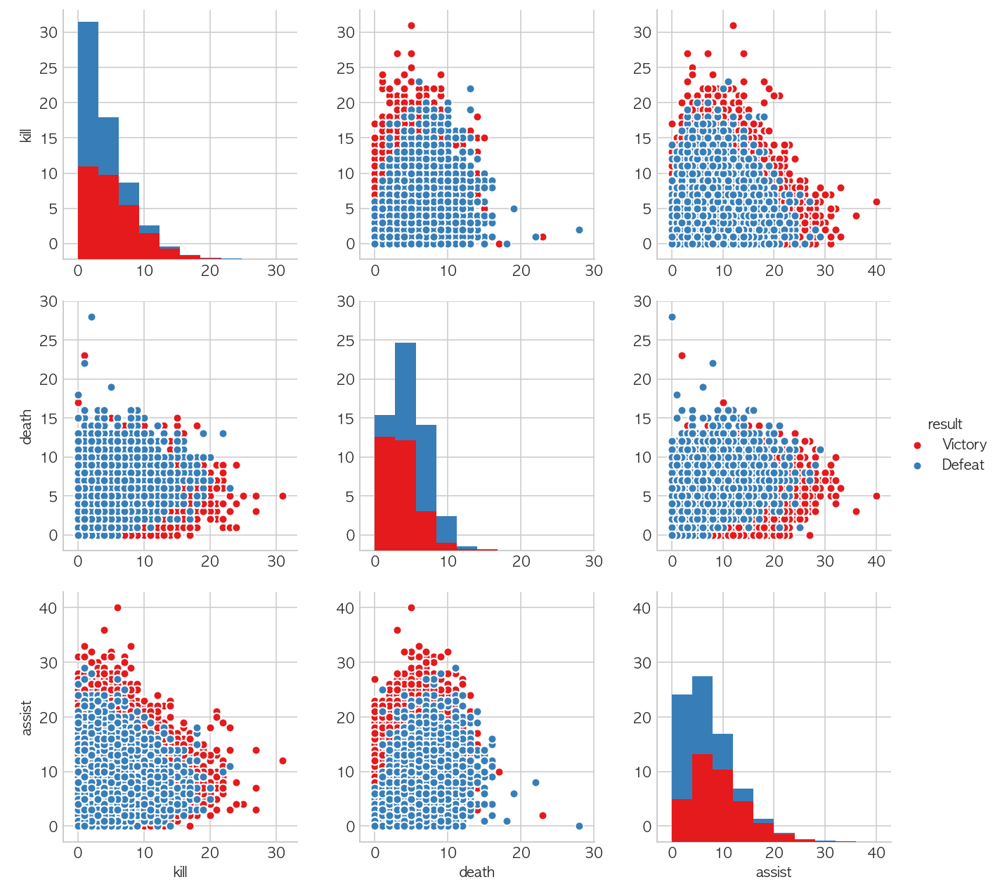

In [7]:
train_kda =  train.loc[:, ['kill', 'death', 'assist', 'result']]

sns.pairplot(train_kda, hue='result', palette='Set1', size=3)
plt.show()

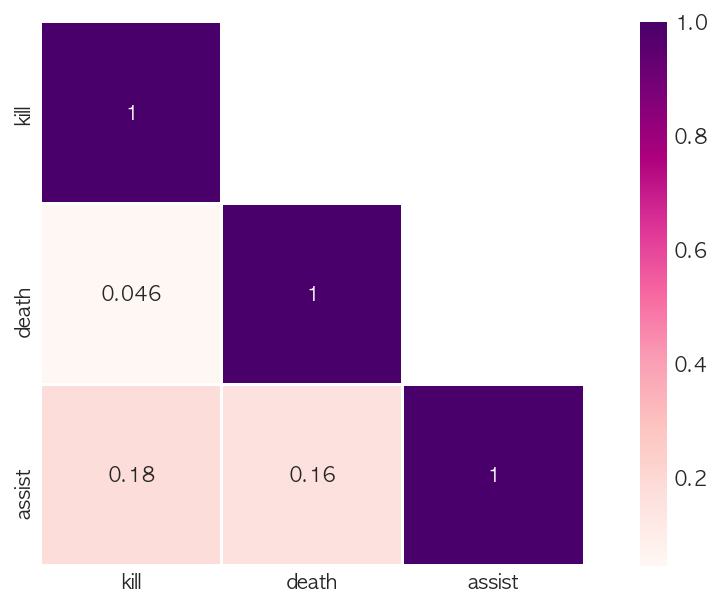

In [8]:
corr_matt = train_kda.corr()
mask = np.array(corr_matt)
mask[np.tril_indices_from(mask)] = False

fig, ax = plt.subplots()
fig.set_size_inches(10, 5)
sns.heatmap(corr_matt, mask=mask, annot=True,
            square=True, linewidths=1, cmap="RdPu")
plt.show()

## 2. CS/분당 CS/와드/플레이 시간과의 상관관계

- CS와 분당 CS 모두 승리 시 높음
- 승리 시 와드 개수가 더 많음
- 게임 결과에 따른 플레이 시간은 차이 없음

In [9]:
fig = tools.make_subplots(rows=1, cols=4)
data = []
for idx, val in enumerate(['cs', 'cs_m', 'wards', 'time']):
    trace = go.Box(
        x=train['result'],
        y=train[val],
        name=val,
        opacity=0.8,
    )
    data.append(trace)
    
for idx, val in enumerate(data):
    fig.append_trace(val, 1, idx+1)

fig['layout'].update(title='CS, CS/M, Wards and Play Time by Result')
py.iplot(fig)

This is the format of your plot grid:
[ (1,1) x1,y1 ]  [ (1,2) x2,y2 ]  [ (1,3) x3,y3 ]  [ (1,4) x4,y4 ]



- 와드를 설치한 경우 승리가 조금 더 많음
- 와드의 개수가 10개가 넘어가는 경우, 경기 후반부라 승패와 큰 상관관계가 없어 보임

In [10]:
wards_groupd = train.pivot_table(values='time', 
                                 index='result',
                                 columns=['wards'],
                                 aggfunc='count')

data = []
for idx, val in enumerate(train['result'].unique()):
    trace = go.Bar(
        x=wards_groupd.columns,
        y=wards_groupd.loc[val],
        marker=dict(
            color=colors[idx]
        ),
        name=val,
        opacity=0.8,
    )
    data.append(trace)

layout = go.Layout(
    title='Result and Distribution of Wards Usage',
    barmode='group',
    xaxis=dict(
        title='Number of Wards'
    ),
    margin=go.Margin(
        l=50,
        r=50,
        b=100,
        t=100,
    ),
)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

### 2.1 분당 CS와 CS의 관계
- 분당 CS는 CS에 대해 로그 함수 형태로 증가

In [11]:
# classes=list(train['result'].unique())
# class_code={classes[k]: k for k in range(len(classes))}
# color_vals=[class_code[cl] for cl in train['result']]
# pl_colorscale=[[0.0, colors[0]], [1, colors[1]]]
# text=[train.loc[k, 'result'] for k in range(len(train))]

# trace1 = go.Splom(dimensions=[dict(label='cs',
#                                    values=train['cs']),
#                               dict(label='cs_m',
#                                    values=train['cs_m'])],
#                   text=text,
#                   marker=dict(color=color_vals,
#                               size=7,
#                               colorscale=pl_colorscale,
#                               showscale=False,
#                               line=dict(width=0.5,
#                                         color='#ffffff')),
#                   opacity=0.6,
#                   diagonal=dict(visible=False)
#                  )

# axis = dict(showline=True,
#             zeroline=False,
#             gridcolor='#fff',
#             ticklen=4)

# layout = go.Layout(
#     title='CS & CS per Minutes',
#     dragmode='select',
#     width=600,
#     height=600,
#     autosize=False,
#     hovermode='closest',
#     plot_bgcolor='rgba(240,240,240, 0.95)',
#     xaxis1=dict(axis),
#     xaxis2=dict(axis),
#     yaxis1=dict(axis),
#     yaxis2=dict(axis),
# )

# fig = dict(data=[trace1], layout=layout)
# py.iplot(fig)

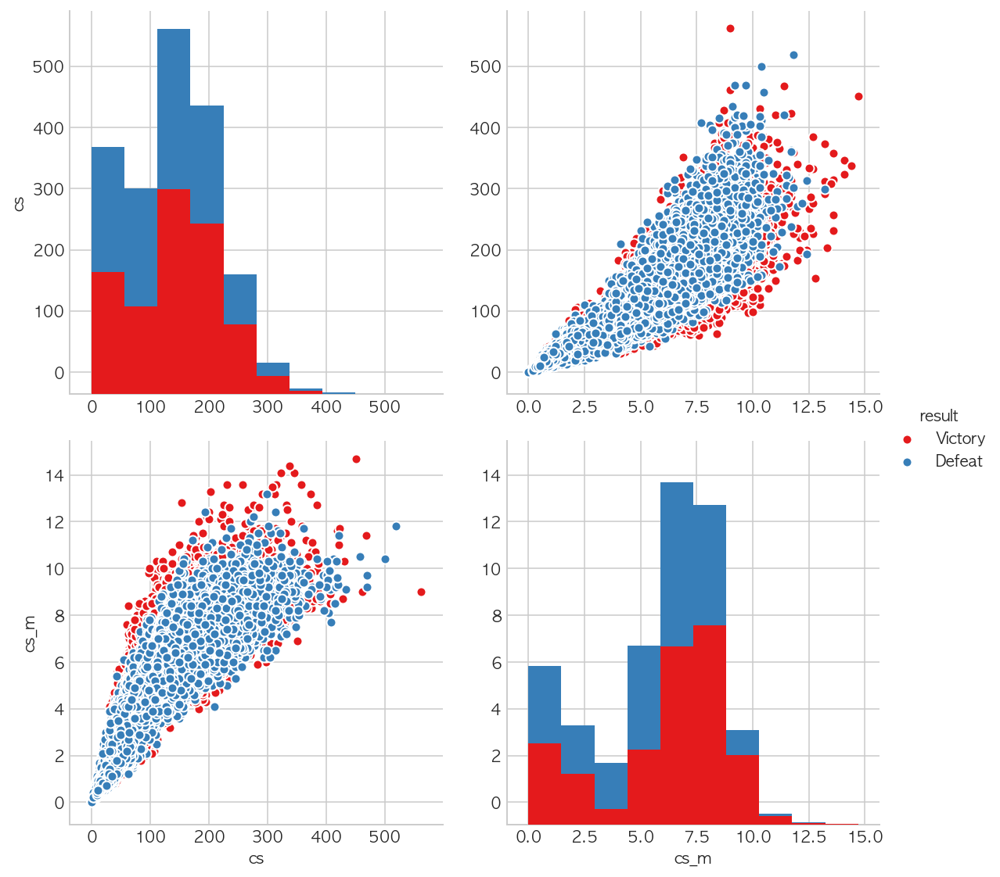

In [12]:
train_cs =  train.loc[:, ['cs', 'cs_m', 'result']]
sns.pairplot(train_cs, hue='result', palette='Set1', size=4)
plt.show()

## 3. 승패와 KDA의 상관관계

### 3.1 KDA 분포
- Perfect (Death 없음) 기록은 601건
- Perfect를 제외한 KDA 최대/최소는 35/0.14
- inf 처리: KDA 최댓값으로 패딩

In [13]:
max_kda = max(train.loc[train['kda']!=np.inf]['kda'])
min_kda = min(train.loc[train['kda']]['kda'])

print(len(train[train['kda']==np.inf]))
print(max_kda)
print(min_kda)

1196
32.0
0.4


- Perfect인 경우 97% 승리
- Perfect이면서 패배한 경우에는 Kill/Assist 모두 이긴 경우보다 낮았음

In [14]:
train[train['kda']==np.inf]['result'].value_counts()

Victory    1161
Defeat       35
Name: result, dtype: int64

In [15]:
perf = train[train['kda']==np.inf]
perf_defeat = perf[perf['result']=='Defeat']
perf_defeat.head()

,result,tier,time,kill,death,assist,kda,p_kill,wards,cs,cs_m
9,Defeat,Diamond 1,18.12,1.0,0.0,0.0,inf,0.09,2.0,157.0,8.7
160,Defeat,Diamond 1,11.20,1.0,0.0,1.0,inf,0.50,1.0,66.0,5.9
322,Defeat,Diamond 1,15.93,3.0,0.0,3.0,inf,0.86,2.0,29.0,1.8
1376,Defeat,Master,17.73,1.0,0.0,2.0,inf,0.75,3.0,25.0,1.4
2282,Defeat,Master,21.20,0.0,0.0,1.0,inf,0.14,6.0,18.0,0.8


In [16]:
train[train['kda']==max_kda]

,result,tier,time,kill,death,assist,kda,p_kill,wards,cs,cs_m
13776,Defeat,Master,36.83,7.0,1.0,25.0,32.0,0.8,1.0,245.0,6.7


In [17]:
print(len(train[train['kda']==min_kda]))
train[train['kda']==min_kda].head()

143


,result,tier,time,kill,death,assist,kda,p_kill,wards,cs,cs_m
2,Defeat,Diamond 1,15.57,1.0,5.0,1.0,0.4,0.22,1.0,67.0,4.3
441,Defeat,Diamond 1,20.12,1.0,5.0,1.0,0.4,0.20,1.0,169.0,8.4
944,Defeat,Master,26.08,1.0,5.0,1.0,0.4,0.18,1.0,211.0,8.1
954,Defeat,Master,15.27,1.0,5.0,1.0,0.4,0.33,2.0,17.0,1.1
1016,Defeat,Diamond 1,27.80,0.0,10.0,4.0,0.4,0.36,5.0,186.0,6.7


- Perfect KDA는 최댓값으로 Padding (KDA 3 이상은 큰 의미가 없다고 판단)

In [18]:
idx = train['kda']==np.inf
train.loc[idx, 'kda'] = max_kda
len(train[train['kda']==np.inf])

0

### 3.2 KDA 1 (1인분) 이상/미만 경우

- KDA 1 이상일 경우, 승리할 확률 증가
- KDA 1 미만인 경우에는 대부분 패배

In [19]:
kda_over_1 = train[train['kda'] >= 1.00]
kda_under_1 = train[train['kda'] < 1.00]

print(len(kda_over_1))
print(len(kda_under_1))

20436
3474


In [20]:
victory = train['result'].value_counts()[0]
defeat = train['result'].value_counts()[1]

r_victory = victory / len(train)
r_defeat = defeat / len(train)

print('Victory/Defeat Ratio')
print('-'*40)
print('Victory Ratio:', round(r_victory, 2))
print('Defeat Ratio:', round(r_defeat, 2))

Victory/Defeat Ratio
----------------------------------------
Victory Ratio: 0.54
Defeat Ratio: 0.46


In [21]:
kda_over_1['result'].value_counts()[0]

12666

In [22]:
print('KDA 1이상인 경우 승패:')
print('-'*40)
print('Victory:', kda_over_1['result'].value_counts()[0])
print('Victory:', kda_over_1['result'].value_counts()[1])
print('')
print('KDA 1이하인 경우 승패:')
print('-'*40)
print('Victory:', kda_under_1['result'].value_counts()[0])
print('Victory:', kda_under_1['result'].value_counts()[1])

KDA 1이상인 경우 승패:
----------------------------------------
Victory: 12666
Victory: 7770

KDA 1이하인 경우 승패:
----------------------------------------
Victory: 3330
Victory: 144


In [23]:
victory = kda_over_1['result'].value_counts()[0]
defeat = kda_over_1['result'].value_counts()[1]

r_victory = victory / len(kda_over_1)
r_defeat = defeat / len(kda_over_1)

print('Victory/Defeat Ratio with KDA over 1')
print('-'*40)
print('Victory Ratio:', round(r_victory, 2))
print('Defeat Ratio:', round(r_defeat, 2))

Victory/Defeat Ratio with KDA over 1
----------------------------------------
Victory Ratio: 0.62
Defeat Ratio: 0.38


In [24]:
fig = tools.make_subplots(rows=1, cols=2)

trace1 = go.Box(
    x=kda_over_1['result'],
    y=kda_over_1['kda'],
    name='KDA over 1'
)

trace2 = go.Box(
    x=kda_under_1['result'],
    y=kda_under_1['kda'],
    name='KDA under 1'
)

fig.append_trace(trace1, 1, 1)
fig.append_trace(trace2, 1, 2)

fig['layout'].update(title='KDA over/under 1')
py.iplot(fig)

This is the format of your plot grid:
[ (1,1) x1,y1 ]  [ (1,2) x2,y2 ]



### 3.3 승패와 구간별 KDA

- KDA 2 미만이면 패배가 더 많음
- KDA 2점대에서는 승패가 비슷
- KDA 3이상에서는 승리가 더 많음

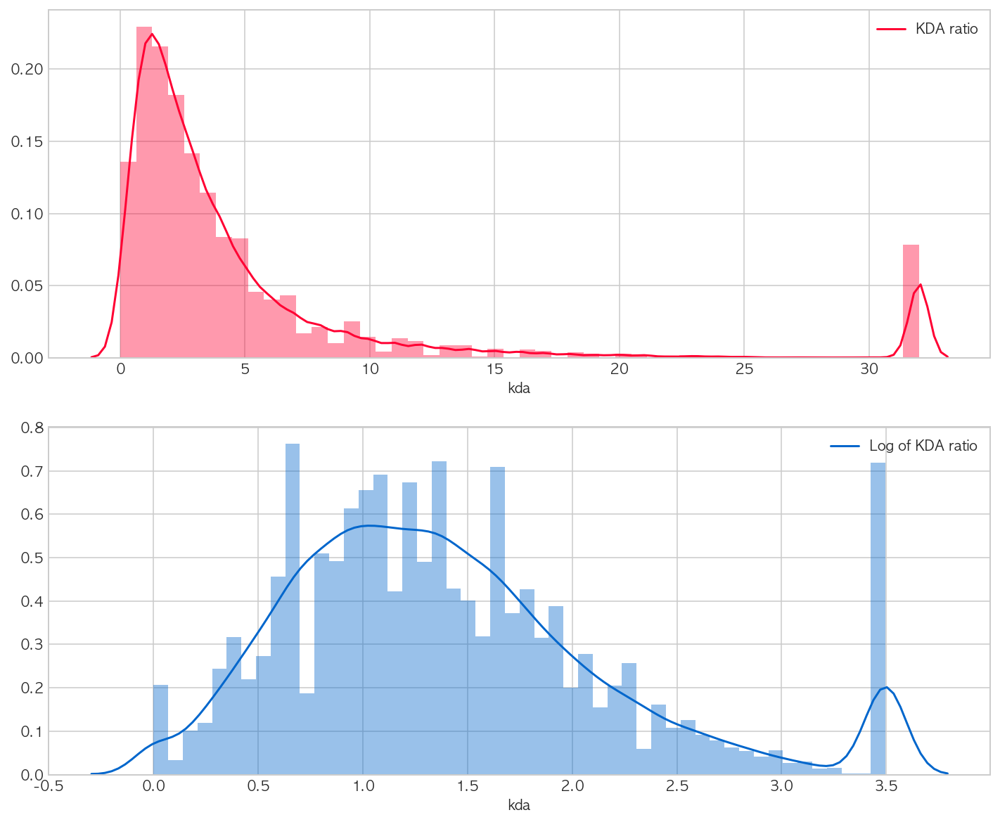

In [25]:
plt.figure(figsize=(12, 10))

plt.subplot(211)
sns.distplot(train[train['kda']!=np.inf]['kda'], 
             color=colors[0],
             kde_kws={'label': 'KDA ratio'})
plt.subplot(212)
sns.distplot(np.log1p(train[train['kda']!=np.inf]['kda']), 
             color=colors[1],
             kde_kws={'label': 'Log of KDA ratio'})
plt.show()

In [26]:
train['kda_range'] = train['kda'].apply(categorize_kda)
print('KDA Rrange/Counts:')
print('-'*40)
print(dict(train['kda_range'].value_counts()))

KDA Rrange/Counts:
----------------------------------------
{3: 11097, 1: 5419, 2: 3920, 0: 3474}


In [27]:
kda_range_groupd = train.pivot_table(values='time', 
                                     index='result',
                                     columns=['kda_range'],
                                     aggfunc='count')
kda_range_groupd

kda_range,0,1,2,3
result,,,,
Defeat,3330,4413,1996,1361
Victory,144,1006,1924,9736


In [28]:
data = []
for idx, val in enumerate(train['result'].unique()):
    trace = go.Bar(
        x=kda_range_groupd.columns,
        y=kda_range_groupd.loc[val],
        marker=dict(
            color=colors[idx]
        ),
        name=val,
        opacity=0.8,
    )
    data.append(trace)

layout = go.Layout(
    title='Distribution of Result by KDA Range',
    barmode='group',
    xaxis=dict(
        title='KDA Range'
    ),
    margin=go.Margin(
        l=50,
        r=50,
        b=100,
        t=100,
    ),
)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

## 4. 킬 기여도와 승패

### 4.1 전체 킬 기여도와 승패

- 킬 기여도에 따르 큰 변화는 없어 보임

In [29]:
trace1 = go.Box(
    x=list(train[train['result']=='Victory']['result']),
    y=list(train[train['result']=='Victory']['p_kill']),
    name='Kill Contribution/Victory',
    marker=dict(
        color=colors[0]
    )
)

trace2 = go.Box(
    x=list(train[train['result']=='Defeat']['result']),
    y=list(train[train['result']=='Defeat']['p_kill']),
    name='Kill Contribution/Defeat',
    marker=dict(
        color=colors[1]
    )
)

layout = go.Layout(
    title='Result by Kill Contribution'
)

data = [trace1, trace2]
fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

### 4.2 킬 기여도 0.5 이상/이하인 경우

- 각 경우에 큰 차이는 없음

In [30]:
high_p_kill = train[train['p_kill'] >= 0.5]
low_p_kill = train[train['p_kill'] < 0.5]

fig = tools.make_subplots(rows=1, cols=2)

trace1 = go.Box(
    x=high_p_kill['result'],
    y=high_p_kill['p_kill'],
    name='High Kill Contribution'
)

trace2 = go.Box(
    x=low_p_kill['result'],
    y=low_p_kill['p_kill'],
    name='Low Kill Contribution'
)

fig.append_trace(trace1, 1, 1)
fig.append_trace(trace2, 1, 2)

fig['layout'].update(title='Result by Kill Contribution')
fig['layout']['yaxis1'].update(title='Kill Contribution')
py.iplot(fig)

This is the format of your plot grid:
[ (1,1) x1,y1 ]  [ (1,2) x2,y2 ]



## 5. 티어간 상관관계

In [31]:
tier_info = list(train['tier'].unique())
tier_pivot = train.pivot_table(values='time', 
                               index='result',
                               columns=['tier'],
                               aggfunc='count')
tier_pivot = tier_pivot[tier_info]
tier_pivot

tier,Master,Challenger,Diamond 1,Diamond 2
result,,,,
Defeat,4022,1250,5605,223
Victory,4936,1506,6204,164


In [32]:
data = []
for idx, val in enumerate(train['result'].unique()):
    trace = go.Bar(
        x=tier_pivot.columns,
        y=tier_pivot.loc[val],
        marker=dict(
            color=colors[idx]
        ),
        name=val,
        opacity=0.8
    )
    data.append(trace)

layout = go.Layout(
    title='Distribution of Result by Tier',
    barmode='group',
    xaxis=dict(
        title='Tier'
    ),
    margin=go.Margin(
        l=50,
        r=50,
        b=100,
        t=100,
    ),
)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

In [33]:
data = []
for i in range(len(tier_info)):
    trace = go.Box(
        x=list(train[train['tier']==tier_info[i]]['result']),
        y=list(train[train['tier']==tier_info[i]]['kda']),
        name=tier_info[i]
    )
    data.append(trace)

layout = go.Layout(
    yaxis=dict(
        title='KDA',
        zeroline=False
    ),
    boxmode='group', 
    title='KDA by Tier/Result'
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

In [34]:
data = []
for i in range(len(tier_info)):
    trace = go.Box(
        x=list(train[train['tier']==tier_info[i]]['result']),
        y=list(train[train['tier']==tier_info[i]]['p_kill']),
        name=tier_info[i]
    )
    data.append(trace)

layout = go.Layout(
    yaxis=dict(
        title='Contribution to Total Kill',
        zeroline=False
    ),
    boxmode='group', 
    title='Kill Contribution by Tier/Result'
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

## 6. 전체 변수간 상관관계

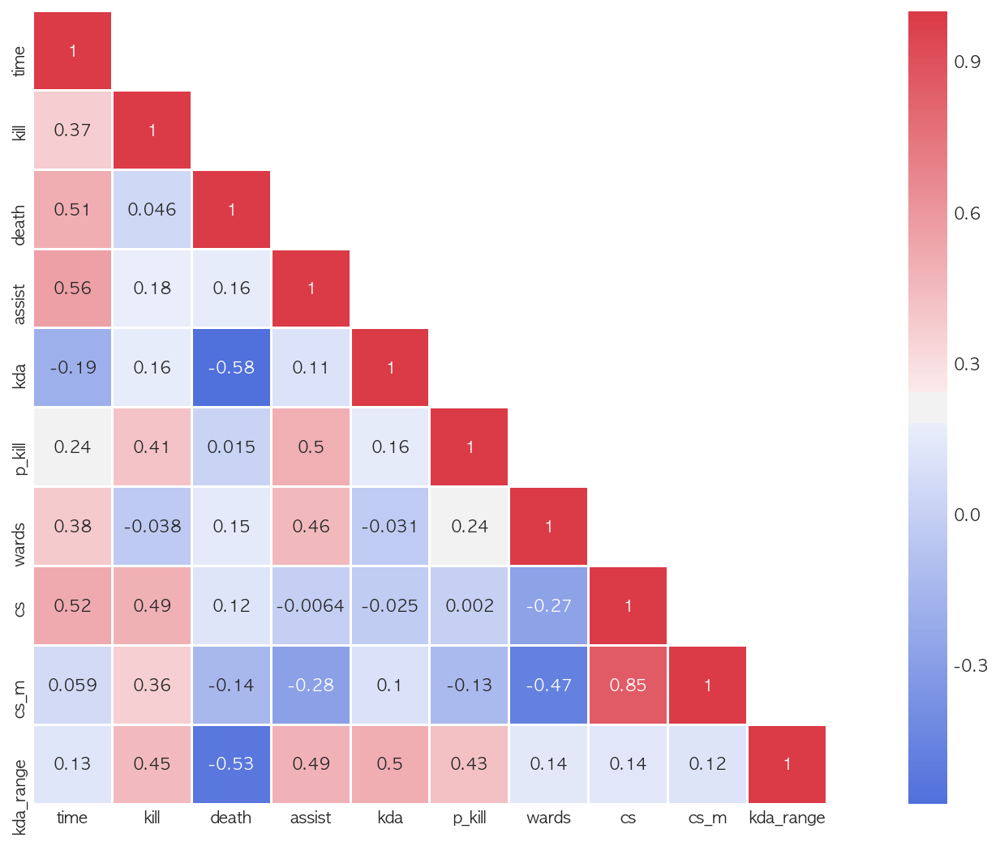

In [35]:
matt = train.iloc[:, 1:]

corr_matt = matt.corr()
mask = np.array(corr_matt)
mask[np.tril_indices_from(mask)] = False
cmap = sns.diverging_palette(-100, 10, as_cmap=True)

fig, ax = plt.subplots()
fig.set_size_inches(18, 9)
sns.heatmap(corr_matt, mask=mask, annot=True,
            square=True, linewidths=1, cmap=cmap)
plt.show()